# Introduction

Credit card fraud has been an old and persistent  problem for the industry and with the advance of technology the threats have become more complex. Thus it has become indispensable to use state-of-the-art systems with learning capabilities, as companies strive to stay ahead. This reflects how organised crime and state-sponsored fraudsters are stepping up their fraud efforts.


The fight against online payment fraud in 2020 also highlights the security concerns associated with the rise of mobile apps and online platforms that make it easier to transfer money from one bank account to another, such as PayPal and MasterCard. Losses from digital money fraud are expected to increase by 130% by 2024, [Source](https://medium.com/swlh/machine-learning-based-digital-fraud-detection-bad492232eb6)



According   to PwC’s 2018 Global Economic Crime and Fraud Survey, from the   interviews with 7,200 C-level and senior management respondents across 123 different nations and territories, they  found that 42% of companies said they had increased funds used to combat fraud or economic crime. In addition, 34% of the C-level and senior management executives also said that existing approaches to combatting online fraud was generating too many false positives.[Source](https://www.forbes.com/sites/louiscolumbus/2019/08/01/ai-is-predicting-the-future-of-online-fraud-detection/#4466640f74f5) Thus, reliable machine learning techniques are more than needed to keep up with the current situation.  




# Project description

Our task is to analize and create models that help us  to dentify if a transaction is fraudulent or not. The data set used comes  from  Kaggle website [Source](https://www.kaggle.com/mlg-ulb/creditcardfraud/tasks) and the informacion of the dataset is as follows: <br>

The datasets contains transactions made by credit cards in September 2013 by european cardholders.
This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions. The dataset is highly unbalanced, the positive class (frauds) account for 0.172% of all transactions. It contains only numerical input variables which are the result of a PCA transformation. Unfortunately, due to confidentiality issues, we cannot provide the original features and more background information about the data. Features V1, V2, … V28 are the principal components obtained with PCA, the only features which have not been transformed with PCA are 'Time' and 'Amount'. Feature 'Time' contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature 'Amount' is the transaction Amount.Feature 'Class' is the response variable and it takes value 1 in case of fraud and 0 otherwise. 


## OUTLINE

* [Introduction](#Introduction )<br>
* [Project description](#Project-description)<br>
* [Dataset](#Dataset)<br>
* [Exploratory Data Analysis](#Exploratory-Data-Analysis) <br>
* [Data visualization](#Data-visualization)<br>
* [Initial Outliers, preemptive analysis](#Initial-Outliers,-preemptive-analysis)<br>
* [Standardization](#Standardization)<br>
*[]()<br>
*[]()<br>
*[]()<br>

In [1]:
#Libraries
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np
import plotly.graph_objects as go
import seaborn as sns



# Dataset
We show a general overview of the dataset and the features in it. 
Let us take a look to our training dataset. All the variables $V_i$ $i=1,...,28$ have positive and negative values and the row for Time doesn't seem to be time ordered. Furthermore there are not null values and all the columns are of type float except for the Class columns which are int type. 

In [2]:

pd.set_option('display.max_columns', None)

creditcard_df = pd.read_csv('creditcard_train.csv')
creditcard_df

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,33419.0,-2.178201,-3.132187,1.315758,-0.129783,-2.736013,0.743459,-0.752718,-2.650826,-0.184284,-1.392226,-1.114831,0.253591,-0.428280,-0.724290,-2.442338,0.649252,1.192440,-1.782696,0.014677,2.534626,-0.828762,-0.219136,-1.004913,0.788588,1.061994,-0.319407,-0.132313,0.333476,937.75,0
1,151317.0,2.064423,0.185575,-1.684612,0.411066,0.479555,-0.797963,0.205544,-0.240568,0.415454,-0.401418,-0.411296,0.439120,0.554022,-0.936324,0.196285,0.227611,0.510030,-0.465360,-0.031358,-0.130661,-0.351331,-0.876025,0.343288,0.522189,-0.259568,0.173623,-0.056280,-0.029665,1.98,0
2,132434.0,-0.547505,0.798072,-0.719939,-1.129561,0.925708,0.763338,0.231338,0.799204,-0.277812,-0.348452,0.511676,-0.034514,-1.390963,1.067757,0.423194,-0.262177,-0.003822,-0.601821,-0.988247,-0.313966,0.366664,1.068933,-0.101523,-1.604148,-0.318277,0.838076,0.012324,-0.015564,11.95,0
3,81787.0,-0.945710,0.323579,0.595681,-1.288095,0.818906,-0.748491,0.890076,-0.130671,-0.471365,-0.389743,0.537702,0.137711,-0.555964,0.457870,-0.277456,0.662419,-0.951232,-0.103400,0.466225,-0.263767,-0.371528,-1.149510,0.217859,-0.507989,-0.026857,0.591496,-0.326179,-0.007543,24.98,0
4,125062.0,1.898722,-0.321038,-1.771837,0.672408,0.115019,-1.267347,0.612810,-0.441070,0.450298,0.107004,-1.144233,-0.035721,-0.728277,0.565399,-0.368894,-0.494280,-0.107078,-0.658594,0.169095,-0.082106,0.015111,0.006269,-0.029094,-0.071333,0.179444,0.378225,-0.106042,-0.059506,104.36,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199359,140177.0,2.164466,-1.721358,0.118546,-1.363516,-2.147961,-0.486731,-1.755439,-0.023992,-0.563216,1.457773,-1.097192,-0.654407,0.621714,-0.925904,0.076346,-0.105142,0.329165,0.269093,-0.346530,-0.356177,-0.123266,0.138772,0.319598,0.018634,-0.560967,-0.251774,0.060706,-0.023599,48.00,0
199360,71541.0,1.070134,0.181228,0.670405,1.351215,-0.617646,-1.019820,0.203157,-0.194571,-0.043719,-0.006449,-0.021080,0.380856,-0.011871,0.369452,0.981649,0.211580,-0.374066,-0.524216,-0.440469,-0.018276,-0.260380,-0.931052,0.149692,0.647047,0.204529,-0.739666,0.012326,0.046917,70.00,0
199361,128249.0,2.111207,-0.687175,-1.637544,-1.931276,-0.244434,-1.065946,-0.062955,-0.269111,2.439795,-1.334028,-0.857487,0.928522,-0.293575,0.177409,0.459425,-1.582800,0.227376,-0.173021,1.221354,-0.220178,0.115593,0.742015,-0.011124,0.731225,0.455436,-0.671152,0.039939,-0.051133,7.99,0
199362,123408.0,1.893443,0.551151,-1.145498,3.889379,0.570851,-0.580469,0.635586,-0.266040,-1.032785,1.478749,-1.421178,-0.602395,-0.938759,0.562817,-1.291184,0.346647,-0.457061,-0.707557,-1.285782,-0.302385,-0.009592,-0.038580,0.078061,0.007246,0.183011,0.016792,-0.072975,-0.056060,37.92,0


In [3]:
creditcard_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199364 entries, 0 to 199363
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    199364 non-null  float64
 1   V1      199364 non-null  float64
 2   V2      199364 non-null  float64
 3   V3      199364 non-null  float64
 4   V4      199364 non-null  float64
 5   V5      199364 non-null  float64
 6   V6      199364 non-null  float64
 7   V7      199364 non-null  float64
 8   V8      199364 non-null  float64
 9   V9      199364 non-null  float64
 10  V10     199364 non-null  float64
 11  V11     199364 non-null  float64
 12  V12     199364 non-null  float64
 13  V13     199364 non-null  float64
 14  V14     199364 non-null  float64
 15  V15     199364 non-null  float64
 16  V16     199364 non-null  float64
 17  V17     199364 non-null  float64
 18  V18     199364 non-null  float64
 19  V19     199364 non-null  float64
 20  V20     199364 non-null  float64
 21  V21     19

In [4]:
#pd.reset_option('display.max_columns')
creditcard_df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000,199364.000000
mean,94806.201064,0.004189,0.000392,-0.002316,0.000110,-0.003293,0.003792,-0.000129,-0.000857,0.002895,0.001041,0.000077,-0.002006,0.001160,-0.000258,0.000560,-0.000395,-0.000772,0.000597,-0.000368,-0.000309,-0.000028,-0.001376,-0.000462,0.000478,-0.000190,0.000116,-0.000274,0.000278,88.761549,0.001826
std,47511.693849,1.954728,1.638375,1.519695,1.416631,1.388592,1.336094,1.251271,1.190237,1.101838,1.094637,1.021992,1.002369,0.995639,0.961117,0.914456,0.875853,0.848747,0.838427,0.811554,0.770321,0.734482,0.725571,0.632179,0.605276,0.521180,0.482254,0.405695,0.329847,253.776731,0.042691
min,0.000000,-56.407510,-72.715728,-48.325589,-5.683171,-113.743307,-26.160506,-43.557242,-50.688419,-13.434066,-24.588262,-4.797473,-18.683715,-3.961758,-19.214325,-4.498945,-14.129855,-25.162799,-9.498746,-6.938297,-54.497720,-22.889347,-9.499423,-44.807735,-2.824849,-10.295397,-2.604551,-22.565679,-15.430084,0.000000,0.000000
25%,54206.250000,-0.918115,-0.599185,-0.891976,-0.847490,-0.693058,-0.767718,-0.556075,-0.208717,-0.641783,-0.535793,-0.762424,-0.405252,-0.648596,-0.426955,-0.581827,-0.467182,-0.483673,-0.497394,-0.455343,-0.212016,-0.228755,-0.542053,-0.161876,-0.354210,-0.317513,-0.326456,-0.071001,-0.052557,5.500000,0.000000
50%,84650.000000,0.023565,0.064251,0.176980,-0.020333,-0.055181,-0.272738,0.037958,0.022257,-0.048977,-0.092081,-0.031602,0.139518,-0.012932,0.049827,0.048619,0.066828,-0.065560,-0.003895,0.003400,-0.062887,-0.030291,0.006292,-0.010771,0.041266,0.015819,-0.052174,0.001212,0.011287,21.990000,0.000000
75%,139350.250000,1.317063,0.801119,1.025002,0.743043,0.611623,0.400009,0.567911,0.327312,0.600620,0.453708,0.739193,0.618800,0.664330,0.494124,0.649461,0.522571,0.399392,0.501093,0.458792,0.131692,0.185384,0.526400,0.148271,0.440020,0.350613,0.240727,0.090505,0.078089,77.000000,0.000000
max,172792.000000,2.454930,22.057729,9.382558,16.875344,34.801666,73.301626,120.589494,20.007208,15.594995,23.745136,12.018913,4.574082,7.126883,7.754599,8.877742,17.315112,9.207059,4.712398,5.572113,38.117209,27.202839,8.361985,22.083545,4.584549,7.519589,3.517346,31.612198,33.847808,25691.160000,1.000000


Most of the means and standard deviations are close to 0 and 1 respectively but we need to ensure that is for all of the variables, in particular for Amount, and V20 to V28 regarding the standard deviation. This in order to have a better behavour for some models that depend on the distance of the feature space. 

# Exploratory Data Analysis
## Duplicates
We inspected the dataset for duplicates and found  585 of them, we showed which proportion correspond to each class only for exposition purposes. 

In [5]:
creditcard_df.duplicated().sum() #Showing 585 extra rows presenting duplicated information

585

In [6]:
#Lets consider all the rows affected by this duplication effect
creditcard_duplicates=creditcard_df[creditcard_df.duplicated(keep=False) ].sort_values(["Time", "Amount"])
creditcard_duplicates

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
51327,26.0,-0.529912,0.873892,1.347247,0.145457,0.414209,0.100223,0.711206,0.176066,-0.286717,-0.484688,0.872490,0.851636,-0.571745,0.100974,-1.519772,-0.284376,-0.310524,-0.404248,-0.823374,-0.290348,0.046949,0.208105,-0.185548,0.001031,0.098816,-0.552904,-0.073288,0.023307,6.14,0
152621,26.0,-0.529912,0.873892,1.347247,0.145457,0.414209,0.100223,0.711206,0.176066,-0.286717,-0.484688,0.872490,0.851636,-0.571745,0.100974,-1.519772,-0.284376,-0.310524,-0.404248,-0.823374,-0.290348,0.046949,0.208105,-0.185548,0.001031,0.098816,-0.552904,-0.073288,0.023307,6.14,0
83488,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
162734,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
176715,145.0,-2.419486,1.949346,0.552998,0.982710,-0.284815,2.411200,-1.398537,-0.188922,0.675695,0.158123,-1.224834,1.314398,0.304425,-0.290434,-2.014511,-0.772540,0.696610,0.017855,2.177312,-0.277406,1.213390,-1.238354,0.007191,-1.724175,0.239721,-0.313607,-0.187431,0.119472,6.74,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168708,171627.0,-1.464380,1.368119,0.815992,-0.601282,-0.689115,-0.487154,-0.303778,0.884953,0.054065,-0.828015,-1.192581,0.944989,1.372532,-0.036493,-0.208747,0.320086,-0.204910,-0.024821,-0.468859,0.031950,0.287217,0.947825,-0.218773,0.082926,0.044127,0.639270,0.213565,0.119251,6.82,0
12992,172233.0,-2.691642,3.123168,-3.339407,1.017018,-0.293095,-0.167054,-0.745886,2.325616,-1.634651,-1.440241,-0.511918,0.607878,-0.627645,1.023032,-0.888334,0.413444,1.860351,1.316597,1.094512,-0.791037,0.402639,0.259746,-0.086606,-0.097597,0.083693,-0.453584,-1.205466,-0.213020,36.74,0
149684,172233.0,-2.691642,3.123168,-3.339407,1.017018,-0.293095,-0.167054,-0.745886,2.325616,-1.634651,-1.440241,-0.511918,0.607878,-0.627645,1.023032,-0.888334,0.413444,1.860351,1.316597,1.094512,-0.791037,0.402639,0.259746,-0.086606,-0.097597,0.083693,-0.453584,-1.205466,-0.213020,36.74,0
112234,172233.0,-2.667936,3.160505,-3.355984,1.007845,-0.377397,-0.109730,-0.667233,2.309700,-1.639306,-1.449823,-0.508930,0.600035,-0.627313,1.017499,-0.887384,0.420096,1.856497,1.315099,1.096112,-0.821707,0.391483,0.266536,-0.079853,-0.096395,0.086719,-0.451128,-1.183743,-0.222200,55.66,0


In [7]:
#From those rows, 15 belong to the fraud case en 1023 to the valid one
creditcard_duplicates["Class"].value_counts() 

0    1023
1      15
Name: Class, dtype: int64

In [8]:
#From the previous example. From the 1023 affected, we need to eliminate 576 for valid cases and 9 for the fraud ones.
#Need to eliminate 585 rows.
creditcard_duplicates[creditcard_duplicates.duplicated(keep="first")]['Class'].value_counts()

0    576
1      9
Name: Class, dtype: int64

In [9]:
#Eliminating duplicated rows while keeping the first instance of original rows.
creditcard_df.drop_duplicates(keep="first", inplace=True)
creditcard_df

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,33419.0,-2.178201,-3.132187,1.315758,-0.129783,-2.736013,0.743459,-0.752718,-2.650826,-0.184284,-1.392226,-1.114831,0.253591,-0.428280,-0.724290,-2.442338,0.649252,1.192440,-1.782696,0.014677,2.534626,-0.828762,-0.219136,-1.004913,0.788588,1.061994,-0.319407,-0.132313,0.333476,937.75,0
1,151317.0,2.064423,0.185575,-1.684612,0.411066,0.479555,-0.797963,0.205544,-0.240568,0.415454,-0.401418,-0.411296,0.439120,0.554022,-0.936324,0.196285,0.227611,0.510030,-0.465360,-0.031358,-0.130661,-0.351331,-0.876025,0.343288,0.522189,-0.259568,0.173623,-0.056280,-0.029665,1.98,0
2,132434.0,-0.547505,0.798072,-0.719939,-1.129561,0.925708,0.763338,0.231338,0.799204,-0.277812,-0.348452,0.511676,-0.034514,-1.390963,1.067757,0.423194,-0.262177,-0.003822,-0.601821,-0.988247,-0.313966,0.366664,1.068933,-0.101523,-1.604148,-0.318277,0.838076,0.012324,-0.015564,11.95,0
3,81787.0,-0.945710,0.323579,0.595681,-1.288095,0.818906,-0.748491,0.890076,-0.130671,-0.471365,-0.389743,0.537702,0.137711,-0.555964,0.457870,-0.277456,0.662419,-0.951232,-0.103400,0.466225,-0.263767,-0.371528,-1.149510,0.217859,-0.507989,-0.026857,0.591496,-0.326179,-0.007543,24.98,0
4,125062.0,1.898722,-0.321038,-1.771837,0.672408,0.115019,-1.267347,0.612810,-0.441070,0.450298,0.107004,-1.144233,-0.035721,-0.728277,0.565399,-0.368894,-0.494280,-0.107078,-0.658594,0.169095,-0.082106,0.015111,0.006269,-0.029094,-0.071333,0.179444,0.378225,-0.106042,-0.059506,104.36,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199359,140177.0,2.164466,-1.721358,0.118546,-1.363516,-2.147961,-0.486731,-1.755439,-0.023992,-0.563216,1.457773,-1.097192,-0.654407,0.621714,-0.925904,0.076346,-0.105142,0.329165,0.269093,-0.346530,-0.356177,-0.123266,0.138772,0.319598,0.018634,-0.560967,-0.251774,0.060706,-0.023599,48.00,0
199360,71541.0,1.070134,0.181228,0.670405,1.351215,-0.617646,-1.019820,0.203157,-0.194571,-0.043719,-0.006449,-0.021080,0.380856,-0.011871,0.369452,0.981649,0.211580,-0.374066,-0.524216,-0.440469,-0.018276,-0.260380,-0.931052,0.149692,0.647047,0.204529,-0.739666,0.012326,0.046917,70.00,0
199361,128249.0,2.111207,-0.687175,-1.637544,-1.931276,-0.244434,-1.065946,-0.062955,-0.269111,2.439795,-1.334028,-0.857487,0.928522,-0.293575,0.177409,0.459425,-1.582800,0.227376,-0.173021,1.221354,-0.220178,0.115593,0.742015,-0.011124,0.731225,0.455436,-0.671152,0.039939,-0.051133,7.99,0
199362,123408.0,1.893443,0.551151,-1.145498,3.889379,0.570851,-0.580469,0.635586,-0.266040,-1.032785,1.478749,-1.421178,-0.602395,-0.938759,0.562817,-1.291184,0.346647,-0.457061,-0.707557,-1.285782,-0.302385,-0.009592,-0.038580,0.078061,0.007246,0.183011,0.016792,-0.072975,-0.056060,37.92,0


In [10]:
#Check from the number of rows left we eliminated correctly the extra duplicates.
199364-198779

585

In [11]:
#creditcard_TOr=creditcard_df.sort_values("Time") #Time Ordered
#creditcard_TOr

## Data properties
In the following we try to gauge how much data of each class we have. For the training set we have 99.82% of the "valid transactions",  Class=0 and 0.17% for the "fraud transactions", Class=1. <br>
We also assing the correct types to the column Class as category and Time as date type. 

In [12]:
#What is the proportion of each class of data:
number_frauds=len(creditcard_df["Class"][creditcard_df["Class"]==1])
number_valid=len(creditcard_df["Class"][creditcard_df["Class"]==0])
print("number of valid transactions (0):", number_valid, "number of frauds (1): ", number_frauds)
print("Percentage of transactions:")
creditcard_df["Class"].value_counts(normalize=True)*100
#creditcard_df["Class"].value_counts()

number of valid transactions (0): 198424 number of frauds (1):  355
Percentage of transactions:


0    99.82141
1     0.17859
Name: Class, dtype: float64

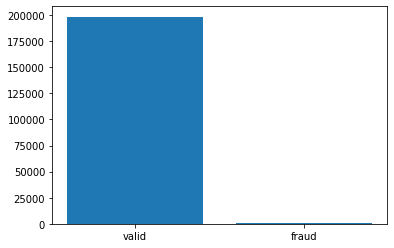

In [13]:
Transactions=[number_valid, number_frauds]
x=[0,1]
plt.bar(x, Transactions)
plt.xticks(x, ('valid', 'fraud'))
plt.show()


In [14]:
#This is just exploring how to tranform the time column
#date_format = "%M"
#pd.to_datetime(creditcard_df['Time'], format=date_format)
#pd.to_datetime(creditcard_TOr['Time'].astype("int64"), format=date_format, errors='coerce')
####pd.to_timedelta(creditcard_TOr['Time'], unit="s")
#creditcard_TOr.iloc[59412].dtype
#creditcard_df["Time"].dtype


In [15]:
Time_unscaled=creditcard_df['Time']
#Converting time column to show the increment in seconds, min, hours, days
creditcard_df['Time']=pd.to_timedelta(creditcard_df['Time'], unit="s")
creditcard_df.sort_values('Time')

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
57264,0 days 00:00:00,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
68734,0 days 00:00:00,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
57847,0 days 00:00:01,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
80391,0 days 00:00:01,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
142316,0 days 00:00:02,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59412,1 days 23:59:46,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,4.356170,-1.593105,2.711941,-0.689256,4.626942,-0.924459,1.107641,1.991691,0.510632,-0.682920,1.475829,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
173860,1 days 23:59:47,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,-0.975926,-0.150189,0.915802,1.214756,-0.675143,1.164931,-0.711757,-0.025693,-1.221179,-1.545556,0.059616,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
77469,1 days 23:59:48,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,-0.399126,-1.933849,-0.962886,-1.042082,0.449624,1.962563,-0.608577,0.509928,1.113981,2.897849,0.127434,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0
109571,1 days 23:59:48,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,-0.484782,0.411614,0.063119,-0.183699,-0.510602,1.329284,0.140716,0.313502,0.395652,-0.577252,0.001396,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0


In [16]:
#Convert "Class feature to category"
#creditcard_df.dtypes
creditcard_df["Class"]=creditcard_df["Class"].astype("category")
creditcard_df.info()
#creditcard_df.describe()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 198779 entries, 0 to 199363
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype          
---  ------  --------------   -----          
 0   Time    198779 non-null  timedelta64[ns]
 1   V1      198779 non-null  float64        
 2   V2      198779 non-null  float64        
 3   V3      198779 non-null  float64        
 4   V4      198779 non-null  float64        
 5   V5      198779 non-null  float64        
 6   V6      198779 non-null  float64        
 7   V7      198779 non-null  float64        
 8   V8      198779 non-null  float64        
 9   V9      198779 non-null  float64        
 10  V10     198779 non-null  float64        
 11  V11     198779 non-null  float64        
 12  V12     198779 non-null  float64        
 13  V13     198779 non-null  float64        
 14  V14     198779 non-null  float64        
 15  V15     198779 non-null  float64        
 16  V16     198779 non-null  float64        
 17  V17     19

In [17]:
#pd.to_numeric()
#dtype('<m8[ns]')
#np.array(creditcard_df["Time"])[0]
#pd.to_numeric(creditcard_df["Time"])


# Data visualization

 ##  Histograms and boxplots.
 In the following we present: 
- Histogram of the transactions over time where we find a pattern discussed below.
- Box plots and histograms of the amount spent per class where we consider to drop some data points from the valid transactions.
- Box plots for each variable Vi per Class where we discuss some glaring outliers and possible elimination
- Heat maps showing the correlations 
- Histogram of each variable Vi for the case of fraud and non-fraud overlaping.<br>
- Show2: box plots of fraud/non-fraud for each Vi<br>
 Inspiration [here](https://www.kaggle.com/janiobachmann/credit-fraud-dealing-with-imbalanced-datasets) <br>
- Show plot of transactions over time fraud/non fraud overlaped. (do same for vi?)Inspiration [here](https://medium.com/analytics-vidhya/detecting-fraudulent-credit-card-operations-with-machine-learning-algorithms-88670bf00275)<br> 
- Show histogram of amount for fraud/non fraud overlaped

We can notice periods of less transactions for both classes. These can be explained as those regions that correspond to night times where activy is naturally lower. 
However, there is no discernible pattern in the histogram between the fraud and valid transactions as they vary through time. Except for a couple of peaks for the fraud class between the hours 0-5 and 25-30 corresponding to the lowest activity for the valid class.  

In [18]:
#Adding extra column to measure time in hours to use in histograms.
#pd2=pd.to_timedelta(creditcard_df['Time'], unit="h")
creditcard_df["Hours"]=creditcard_df['Time']/pd.Timedelta(hours=1)
#creditcard_df.sort_values("Hours")


In [19]:
import plotly.express as px

px.histogram(creditcard_df, y="Amount", x="Hours",color="Class", title="Transactions over time", histnorm="probability",nbins=48)


Following our analysis, we look at the boxplots for the amount spent. There are large outliers for the valid Class that we will remove later on. 

In [21]:
#Amount spent
fig=go.Figure()
fig.add_trace(go.Box(y=creditcard_df["Amount"],x=creditcard_df["Class"]))
fig.update_layout(height=400, title="Box plot for Amount spent")

fig.show()
#str(fig.to_dict())

Getting a sense of the distribution and we can see that for the valid case,  there are quite a few points that we  could drop at least for values >10K.

In [22]:
#Amount spent after dropping outliers >1000 (only for visualisation puposes)
fig=go.Figure()
fig.add_trace(go.Box(y=creditcard_df[creditcard_df["Amount"]<=1000]["Amount"],x=creditcard_df["Class"]))
fig.update_layout(height=400,title="Box plot for Amount spent after dropping outliers >1000")

fig.show()

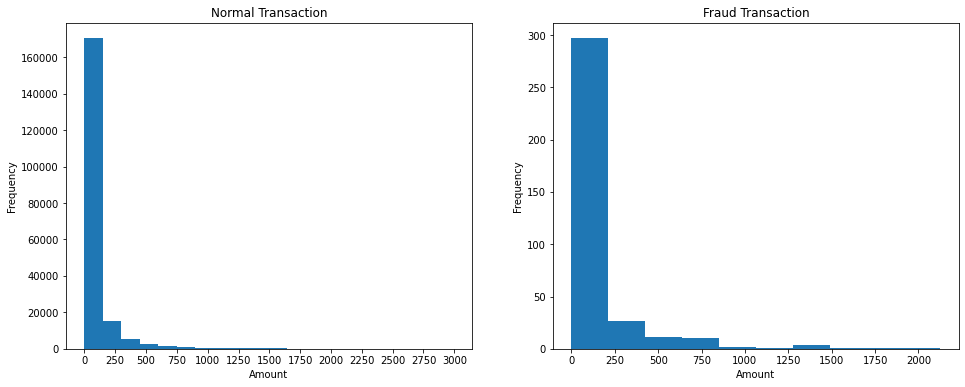

In [23]:
Fraud_transaction = creditcard_df[creditcard_df["Class"]==1 ]
Normal_transaction= creditcard_df[creditcard_df["Class"]==0]
Normal_transaction=Normal_transaction[ Normal_transaction['Amount']<3000]

plt.figure(figsize=(16,6) )
plt.subplot(122)
Fraud_transaction.Amount.plot.hist(title="Fraud Transaction")
plt.xlabel("Amount")
plt.xticks(np.linspace(0,2000, 9))
plt.subplot(121)
Normal_transaction.Amount.plot.hist(title="Normal Transaction", bins=20 )
plt.xlabel("Amount")
plt.xticks(np.linspace(0,3000, 13))
plt.show()


Most of the transactions for both cases are between 0 and 250, thus there is no obvious discrepancy. Only a minor difference is in the range of 1250 to 1500 where there is a bit more activity for the fraudulent transactions. 

We attempted to explore the behavour of the variables Vi vs time but there didn't seemed to be a recognizable pattern.

In [58]:
#px.histogram(creditcard_df, y="V1", x="Hours",color="Class", title="Vi variables over time", histnorm="probability",nbins=48)


In [28]:
#Drop the column for hours
creditcard_df.drop(["Hours"], axis=1, inplace=True)

In [29]:
#Preparing for analysis of the variales Vi, stripping other columns
creditcard_Vs=creditcard_df.drop(["Time","Amount", "Class"],axis=1)
creditcard_Vs.columns #Store names of columns for variables Vi

Index(['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28'],
      dtype='object')

# Initial Outliers, preemptive analysis

We intent to get a sense of the distributions and start to drop a few points mainly from the valid transactions class as they may affect our models later. I decided not to touch the fraud cases at this point since there is not many of them and would rather use a more strict method later on to drop points for that class if necessary.<br>

In [56]:
# #For pretty boxplots activate this cell, otherwise we will use seaborn below

# from plotly.subplots import make_subplots
# import plotly.graph_objects as go
# #print(list(enumerate(creditcard_Vs.columns.tolist())))


# creditcard_Vs=creditcard_df.drop(["Time","Amount", "Class"],axis=1)
# fig = make_subplots(4, 7, subplot_titles=creditcard_Vs.columns)
# for i, Vi in enumerate(creditcard_Vs.columns.tolist()):
#     row = (i // 7) + 1
#     col = (i % 7) + 1
#     #fig.add_trace(
#     fig.add_trace(go.Box(y=creditcard_df[creditcard_df['Class']==0][Vi].to_numpy(), name="Valid"),row=row, col=col)
#     fig.add_trace(go.Box(y=creditcard_df[creditcard_df['Class']==1][Vi].to_numpy(), name="Fraud"),row=row, col=col)

#         # go.Scatter(x=[20, 30, 40], y=[50, 60, 70]),
#         #px.box(creditcard_df[[Vi,"Class"]], "Class", "V1", title=Vi),
#         #go.Box(creditcard_df[[Vi,"Class"]], "Class", "V1")
#         #row=row, col=col
#     #)
# fig.update_layout(showlegend=False, height=1000, title="Boxplots ")
# # #fig.update_yaxes(tickformat="%")
# fig.show()
# #fig.print_grid 


### Boxplots for variables Vi


In the following boxplot for the valid transaccions, Class = 0, there are quite a few outliers that we reckon will affect our modeling. For instance V1, V2, V3, V5, V6, V7, V9, V10, V13, V14, V15, V16, V19, V20, V27, V28 show outliers that exceed in many times more the usual limit ranges of $[4*Q1-3*Q3,  4*Q3-3*Q1 ]$ of the boxplots. We will drop 96 data points by inspecting each of the valid class boxplots.



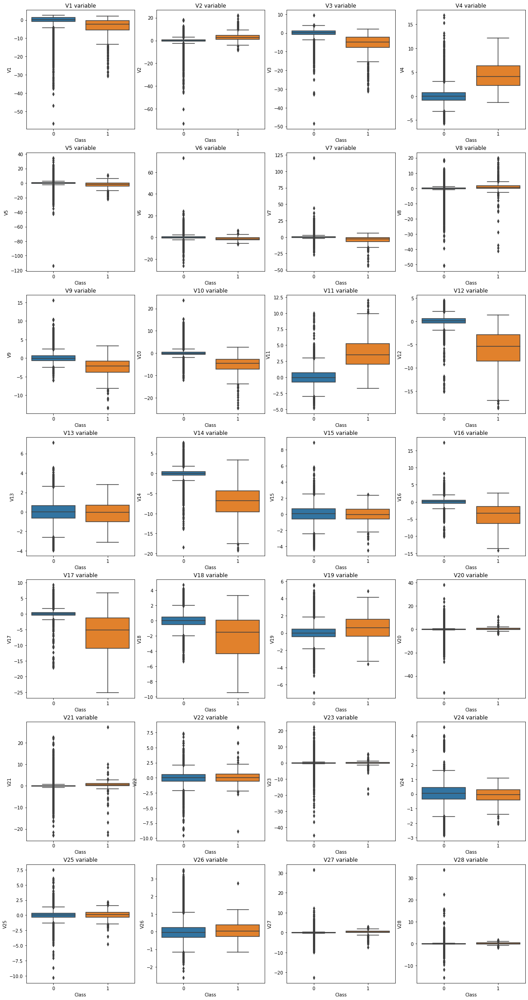

In [32]:
import seaborn as sns

#Store names of columns for variables Vi
creditcard_Vs=creditcard_df.drop(["Time","Amount", "Class"],axis=1)

f,axes=plt.subplots(ncols=4, nrows=7, figsize=(20,40))
#print(axes[0,0])
for i, Vi in enumerate(creditcard_Vs.columns.tolist()):
    row = (i // 4) 
    col = (i % 4) 
    sns.boxplot(x="Class", y=Vi, data=creditcard_df, ax=axes[row,col])
    axes[row,col].set_title(f'{Vi} variable')

Here we analyse each boxt plot individualy to determine which points we drop.


In [59]:
# #Here we analyse each box plot individualy to determine which points we drop.
# fig=go.Figure()
# vi="V1"
# df=creditcard_df #creditcard_drops#
# fig.add_trace(go.Box(y=df[(150>df[vi])&(df[vi]>-105)][vi],x=df["Class"],boxpoints="suspectedoutliers",marker=dict(outliercolor='rgba(219, 64, 82, 0.6)')))
# fig.update_layout(height=400,title="Box plot for Vs")
# fig.show()
#Decided ranges for each box plot Class=0
#V1 -40,3      
#V2  -46,18            
# V3 -44, 20
#V4   -24,9
#V5  -40,35
#V6   -27,40
#V7   -26,36
#V8  -50,17
#V9    -6,9
#V10   -13,15
#V11  -10,11  fakeones
#V12   -10,6
#V13  -4,5
#V14  -15,8
#V15 -5,5
#V16 -11,10
#V17  -12,10
#V18   -6,6 
#V19   -6,5
#V20  -54,23
#V21  -18,19
#V22  -6.5,6
#V23  -30,25
#V24  -3,4
#V25   -6,7.5
#V26   -2.5,4
#V27   -15,15
#V28  -11,13



Here we create a dictionary that will store the maximum intervals of points we are keeping for each boxplot for the valid transactions, (Class=0).

In [34]:
#creditcard_Vs=creditcard_df.drop(["Time","Amount", "Class"],axis=1)
#creditcard_Vs
dict_outliers={'V1':[-40,3   ], 'V2':[-46,18], 'V3':[-44, 20], 'V4':[-24,9], 'V5':[-40,35], 'V6':[-27,40], 'V7':[-26,36], 'V8':[-50,17], 'V9':[-6,9], 'V10':[-13,15], 'V11':[-10,11],
       'V12':[-10,6], 'V13':[-4,5], 'V14':[-15,8], 'V15':[-5,5], 'V16':[-11,10], 'V17':[-12,10], 'V18':[-6,6 ], 'V19':[-6,5], 'V20':[-54,23], 'V21':[-18,19],
       'V22':[-6.5,6], 'V23':[-30,25], 'V24':[-3,4], 'V25':[-6,7.5], 'V26':[-2.5,4], 'V27':[-15,15], 'V28':[-11,13]}
dict_outliers.items()

dict_items([('V1', [-40, 3]), ('V2', [-46, 18]), ('V3', [-44, 20]), ('V4', [-24, 9]), ('V5', [-40, 35]), ('V6', [-27, 40]), ('V7', [-26, 36]), ('V8', [-50, 17]), ('V9', [-6, 9]), ('V10', [-13, 15]), ('V11', [-10, 11]), ('V12', [-10, 6]), ('V13', [-4, 5]), ('V14', [-15, 8]), ('V15', [-5, 5]), ('V16', [-11, 10]), ('V17', [-12, 10]), ('V18', [-6, 6]), ('V19', [-6, 5]), ('V20', [-54, 23]), ('V21', [-18, 19]), ('V22', [-6.5, 6]), ('V23', [-30, 25]), ('V24', [-3, 4]), ('V25', [-6, 7.5]), ('V26', [-2.5, 4]), ('V27', [-15, 15]), ('V28', [-11, 13])])

Dropping the ouliers for the variables $Vi$:

In [35]:
#Lets drop the tentative outliers and see the changes in the general plotboxes
def drop_outliers(df_, dict_outliers):
    newdf=df_.copy(deep=True)
    for key,val in dict_outliers.items():
        min_val=val[0]
        max_val=val[1]
        #print(key,min_val, max_val)
        newdf[newdf["Class"]==0]= newdf[(newdf[key]< max_val) & (newdf[key]>min_val)& (newdf["Class"]==0)]
    return newdf


creditcard_drops=drop_outliers(creditcard_df, dict_outliers)

In [36]:
#creditcard_df[(creditcard_df["V22"]< 6) & (creditcard_df["V22"]>-6.5)]["V22"].max()

## Outliers of the "Amount" column

I decided to drop what I considered where the ouliers for the Amount columns.  I rather be able to detect accurately the fraud cases even if I compromise the number of  False-negatives for this situation is more important to focus on the  False-positives. In other words, is better that our model doesn't to learn from these extreme cases and marks a fraud for a huge amount in the transaction by mistake instead of  allowing this outliers to affect my model and cause to falsely pass  a fraud as a valid transaction. Note that none of the fraud cases are above 1000 as seen in the previous plots so we are not wasting our precious data resources for the fraud cases. 

In [37]:
#Dropping cases where the amount for valid transactions is beyond 1000.
creditcard_drops=creditcard_drops[creditcard_drops["Amount"]<=1000] 

## Boxplots of our variables after dropping tentative outliers 



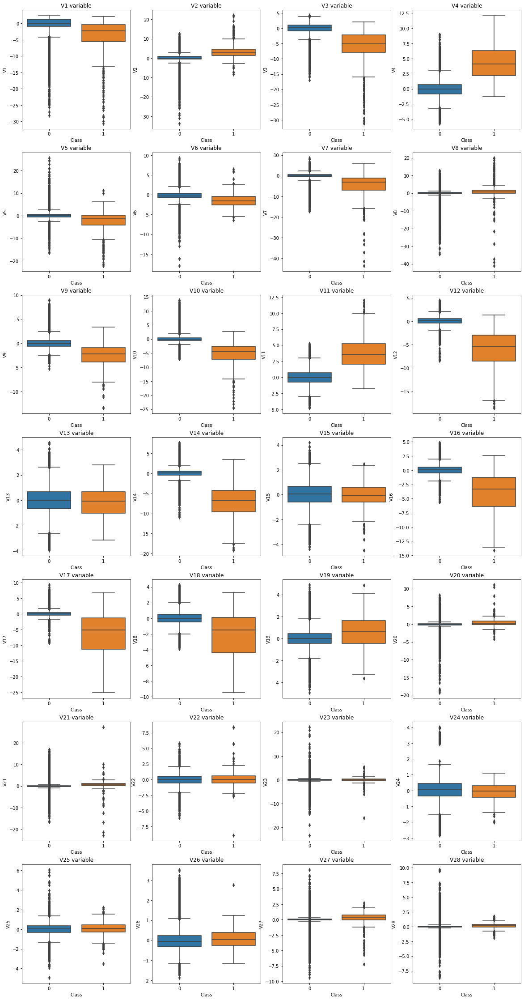

In [38]:
f,axes=plt.subplots(ncols=4, nrows=7, figsize=(20,40))
#print(axes[0,0])
for i, Vi in enumerate(creditcard_Vs.columns.tolist()):
    row = (i // 4) 
    col = (i % 4) 
    #print(row, col)
    sns.boxplot(x="Class", y=Vi, data=creditcard_drops, ax=axes[row,col])
    axes[row,col].set_title(f'{Vi} variable')

### Correlation maps
There was no significative change in our boxplots except for the y-axis in many of them. However if we analise the correlations functions among the variables,  we will start noticing some changes. For starters,  our heatmap before dropping the outliers show dim correlations between the Amount and V2, V5, V7 and V20.  

In [39]:
#Another way of creating boxplots using px
#px.box(creditcard_df[["V1","Class"]], "Class", "V1", title="BoxPlots per class")

In [40]:
fig = px.imshow(creditcard_df.corr(), title="Heatmap variables Vi before processing")
fig.update_layout(height=600)
fig.show()

In [60]:
#196619-198779  #198683

However, after dropping the outliers, we notice slight  signs of correleations among the variables V1-V7 and similarly alongside the axis of V20. It is not very significative but it shows how much difference can make dropping 96 datapoints due to the outliers of the variables Vi and 2064 points due to the outliers of the "Amount" variable for a total of 2160 data point for the valid transactions. (Numbers obtained by comparing the difference of the number of rows between the dataframe creditcard_df and creditcard_drops). We need to point out that one cause for the lack of correlations is due to the imbalance of our data, a topic we will expand later on. However once we balance our data, more meaningful correlations will appear as proved by Janio Martinez [ref](https://www.kaggle.com/janiobachmann/credit-fraud-dealing-with-imbalanced-datasets). However, unlike him, we wanted to show that big outliers have also an influence in the correlations as shown below. 

In [42]:
fig = px.imshow(creditcard_drops.corr(), title="Heatmap variables Vi after processing")
fig.update_layout(height=600)
fig.show()

# Standardization
As mentioned before this step is crucial if we want to obtain good results for certain clustering models such as KNN. In our research we saw different aproaches from just normalizing the Amount column to also include the Time column [ref1](https://www.kaggle.com/janiobachmann/credit-fraud-dealing-with-imbalanced-datasets
) [ref2](https://medium.com/analytics-vidhya/detecting-fraudulent-credit-card-operations-with-machine-learning-algorithms-88670bf00275). However as we discuss in the section (Outliers of the Amount column), the variables Vi are not perfectly normaliced. Moreover, the elimination of the outliers would have affected even more the distribution thus we decided to standardize Time, Amount and all the variables Vi.

From the description of the dataframe, notice that varibles from V20 to V28 and Amount have standard deviation different of  1 similarly the means  and V1 to  V9 fail to be zero by 2 orders of magnitude, and for Amount is close to 70. Thus it will be productive to standardize the variables if we plan to use methods like KNN or similar models that require to put weights in our parameters in order to converge.

In [43]:
creditcard_drops.describe()# 

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
count,196619,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000,196619.000000
mean,1 days 02:20:38.212217537,0.048227,0.057805,0.027655,-0.015989,0.034686,-0.016474,-0.035021,0.010775,0.004398,0.007646,-0.001575,-0.000665,0.000842,-0.002281,0.000242,0.000038,0.000053,0.001387,0.002829,-0.020585,-0.006987,0.004300,0.007377,-0.000126,0.001936,-0.000054,0.000563,-0.000852,70.383089
std,0 days 13:11:51.263578052,1.842066,1.404924,1.460288,1.397394,1.237173,1.274714,1.051306,1.126988,1.091197,1.066829,1.016582,0.991571,0.995540,0.948064,0.912112,0.863723,0.831232,0.833003,0.806417,0.588387,0.679107,0.714236,0.477776,0.604360,0.512334,0.480458,0.367635,0.271380,128.094799
min,0 days 00:00:00,-30.552380,-33.644637,-31.103685,-5.683171,-22.105532,-17.927274,-43.557242,-41.044261,-13.434066,-24.588262,-4.797473,-18.683715,-3.961758,-19.214325,-4.498945,-14.129855,-25.162799,-9.498746,-4.932733,-19.351815,-22.797604,-8.887017,-23.222016,-2.824849,-4.930750,-1.855355,-9.390980,-8.656570,0.000000
25%,0 days 15:04:32,-0.893471,-0.576987,-0.858808,-0.854739,-0.671355,-0.772150,-0.560109,-0.203587,-0.637149,-0.528269,-0.761706,-0.402921,-0.648930,-0.429067,-0.581034,-0.464382,-0.484181,-0.495256,-0.449873,-0.212311,-0.229383,-0.537585,-0.158307,-0.354562,-0.315766,-0.325719,-0.069161,-0.052476,5.400000
50%,0 days 23:31:49,0.047099,0.074272,0.192305,-0.030834,-0.043654,-0.280566,0.030072,0.025164,-0.047420,-0.089116,-0.032579,0.140183,-0.012498,0.046773,0.050013,0.067149,-0.067399,-0.003624,0.005886,-0.064915,-0.032631,0.009641,-0.009514,0.040695,0.017227,-0.051820,0.002056,0.010873,21.100000
75%,1 days 14:42:35.500000,1.326184,0.805847,1.034000,0.726861,0.618986,0.379722,0.551757,0.329781,0.599959,0.457746,0.737641,0.617843,0.664698,0.488626,0.650382,0.520283,0.396796,0.499438,0.460329,0.125543,0.179763,0.528534,0.148086,0.439245,0.351302,0.238845,0.090594,0.075544,74.880000
max,1 days 23:59:52,2.454930,22.057729,4.187811,12.114672,25.604077,9.342677,8.676152,20.007208,8.955669,13.811758,12.018913,4.574082,4.569009,7.667726,4.198583,4.870361,9.207059,4.243841,4.891062,11.059004,27.202839,8.361985,22.083545,3.998294,6.070850,3.517346,8.088549,9.677347,1000.000000


In [44]:
creditcard_drops.shape

(196619, 31)

In [45]:
#Create new variables for standarization do it for time and amount? 

#from sklearn.preprocessing import scale
from sklearn.preprocessing import StandardScaler, RobustScaler


#Standarizing all the variables of my dataset (Vi, Amount and  Time)
dftest = StandardScaler().fit_transform(creditcard_drops.drop(["Time", "Class"],axis=1))
#dftest    # standariced data

#Columns and indexes for the new dataframe
columns_df=creditcard_drops.drop(["Time", "Class"],axis=1).columns.tolist()
indexes_df=creditcard_drops.drop(["Time", "Class"],axis=1).index.tolist()

#Creating data frame for standarized data
dftest2 = pd.DataFrame(dftest, index=indexes_df, columns=columns_df)
#dftest2


#Adding original Class and Time
dftest2.insert(0,"Time",creditcard_drops["Time"])
dftest2["Class"]=creditcard_drops["Class"]
#dftest2


#Dealing with time: standardize Time 
Time_unscaled=pd.to_numeric(creditcard_drops["Time"])
Time_scaled=StandardScaler().fit_transform(Time_unscaled.values.reshape(-1,1))
dftest2.insert(0,"Time scaled", Time_scaled)
#dftest2["Time_unscaled"]=Time_unscaled
dftest2



,Time scaled,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-1.292733,0 days 09:16:59,-1.208661,-2.270586,0.882091,-0.081433,-2.239547,0.596162,-0.682674,-2.361700,-0.172914,-1.312184,-1.095100,0.256419,-0.431045,-0.761563,-2.677945,0.751649,1.434485,-2.141755,0.014693,4.342750,-1.210086,-0.312833,-2.118761,1.305045,2.069084,-0.664685,-0.361436,1.231959,6.771306,0
1,1.188748,1 days 18:01:57,1.094533,0.090945,-1.172558,0.305609,0.359586,-0.613072,0.228826,-0.223023,0.376703,-0.383441,-0.403039,0.443525,0.555659,-0.985213,0.214933,0.263480,0.613520,-0.560319,-0.042393,-0.187082,-0.507056,-1.232545,0.703075,0.864248,-0.510419,0.361483,-0.154618,-0.106173,-0.534005,0
2,0.791305,1 days 12:47:14,-0.323405,0.526910,-0.511951,-0.796894,0.720210,0.611756,0.253360,0.699591,-0.258625,-0.333792,0.504881,-0.034136,-1.398044,1.128658,0.463708,-0.303588,-0.004663,-0.724138,-1.228990,-0.498621,0.550210,1.490595,-0.227933,-2.654091,-0.625010,1.744443,0.031992,-0.054214,-0.456172,0
3,-0.274698,0 days 22:43:07,-0.539579,0.189174,0.388983,-0.910345,0.633882,-0.574261,0.879953,-0.125508,-0.436002,-0.372496,0.530482,0.139553,-0.559302,0.485359,-0.304457,0.766893,-1.144430,-0.125794,0.574637,-0.413303,-0.536797,-1.615450,0.440546,-0.840335,-0.056199,1.231224,-0.888770,-0.024659,-0.354450,0
4,0.636141,1 days 10:44:22,1.004579,-0.269654,-1.232289,0.492630,0.064933,-0.981300,0.616217,-0.400933,0.408635,0.093134,-1.124022,-0.035354,-0.732388,0.598780,-0.404706,-0.572313,-0.128883,-0.792293,0.206179,-0.104558,0.032540,0.002757,-0.076335,-0.117822,0.346472,0.787332,-0.289976,-0.216134,0.265249,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199359,0.954277,1 days 14:56:17,1.148843,-1.266380,0.062242,-0.964317,-1.764226,-0.368912,-1.636462,-0.030850,-0.520177,1.359290,-1.077748,-0.659301,0.623655,-0.974222,0.083438,-0.121776,0.395934,0.321376,-0.433224,-0.570361,-0.171224,0.188275,0.653489,0.031041,-1.098706,-0.523918,0.163595,-0.083821,-0.174739,0
199360,-0.490353,0 days 19:52:21,0.554763,0.087851,0.440154,0.978398,-0.527278,-0.787117,0.226554,-0.182208,-0.044096,-0.013212,-0.019186,0.384765,-0.012770,0.392098,1.075975,0.244919,-0.450079,-0.630975,-0.549715,0.003925,-0.373128,-1.309588,0.297870,1.070843,0.395433,-1.539394,0.031997,0.176022,-0.002991,0
199361,0.703220,1 days 11:37:29,1.119931,-0.530265,-1.140326,-1.370618,-0.225612,-0.823302,-0.026571,-0.248349,2.231864,-1.257631,-0.841953,0.937088,-0.295737,0.189534,0.503430,-1.832581,0.273478,-0.209373,1.511039,-0.339221,0.180501,1.032876,-0.038724,1.210129,0.885169,-1.396791,0.107107,-0.185279,-0.487087,0
199362,0.601328,1 days 10:16:48,1.001713,0.351156,-0.803373,2.794758,0.433380,-0.442450,0.637882,-0.245624,-0.950502,1.378952,-1.396450,-0.606847,-0.943812,0.596056,-1.415867,0.401298,-0.549925,-0.851073,-1.597950,-0.478937,-0.003836,-0.060037,0.147944,0.012198,0.353433,0.035063,-0.200029,-0.203437,-0.253431,0


In [61]:
# fig = px.imshow(dftest2.corr(), title="Heatmap variables Vi including time after standardizing")
# fig.update_layout(height=650)
# fig.show()

Naturally the correlations kept the same after the normalization of the variables. (you can uncomment the line above to corroborate). Also our boxplots keep the same relative position but with the axes reflecting the normalization.

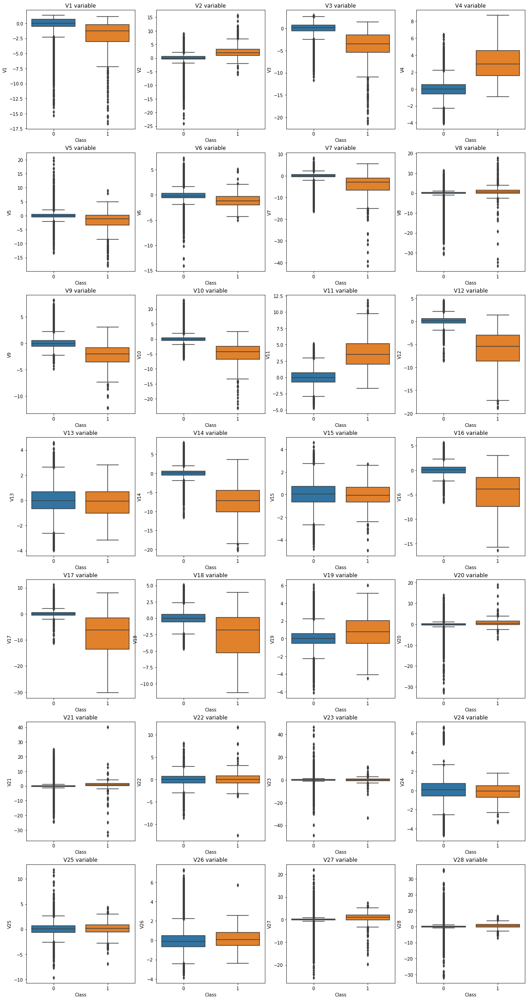

In [47]:
f,axes=plt.subplots(ncols=4, nrows=7, figsize=(20,40))
#print(axes[0,0])
for i, Vi in enumerate(creditcard_Vs.columns.tolist()):
    row = (i // 4) 
    col = (i % 4) 
    #print(row, col)
    sns.boxplot(x="Class", y=Vi, data=dftest2, ax=axes[row,col])
    axes[row,col].set_title(f'{Vi} variable')

We can see that all the variable now have mean and standard deviation equal to 0 and 1. 

In [48]:
dftest2.describe()

,Time scaled,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
count,1.966190e+05,196619,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05,1.966190e+05
mean,-9.402308e-16,1 days 02:20:38.212217537,5.014155e-19,1.091821e-17,4.381739e-19,-5.614950e-18,-3.168855e-18,1.946937e-18,-1.852979e-17,4.806361e-18,6.813152e-18,8.873021e-18,1.421806e-17,9.834067e-18,-2.303377e-18,-3.717702e-18,2.435027e-17,1.142358e-17,-1.659245e-17,3.243390e-18,-1.274883e-17,-3.094321e-18,1.897248e-19,-1.740951e-17,2.981389e-18,-1.341625e-17,9.088720e-18,1.965006e-17,3.212334e-18,6.342228e-18,-1.855237e-17
std,1.000003e+00,0 days 13:11:51.263578052,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00,1.000003e+00
min,-1.996126e+00,0 days 00:00:00,-1.661216e+01,-2.398886e+01,-2.131868e+01,-4.055548e+00,-1.789587e+01,-1.405087e+01,-4.139836e+01,-3.642908e+01,-1.231537e+01,-2.305521e+01,-4.717682e+00,-1.884192e+01,-3.980362e+00,-2.026454e+01,-4.932724e+00,-1.635934e+01,-3.027182e+01,-1.140471e+01,-6.120375e+00,-3.285471e+01,-3.355978e+01,-1.244875e+01,-4.862001e+01,-4.673921e+00,-9.627903e+00,-3.861536e+00,-2.554589e+01,-3.189532e+01,-5.494623e-01
25%,-8.538252e-01,0 days 15:04:32,-5.112196e-01,-4.518344e-01,-6.070486e-01,-6.002260e-01,-5.706905e-01,-5.928212e-01,-4.994641e-01,-1.902083e-01,-5.879311e-01,-5.023452e-01,-7.477340e-01,-4.056762e-01,-6.526848e-01,-4.501666e-01,-6.372869e-01,-5.376975e-01,-5.825511e-01,-5.962097e-01,-5.613763e-01,-3.258516e-01,-3.274841e-01,-7.586938e-01,-3.467825e-01,-5.864669e-01,-6.201095e-01,-6.778231e-01,-1.896553e-01,-1.902311e-01,-5.073060e-01
50%,-2.131966e-01,0 days 23:31:49,-6.124760e-04,1.172121e-02,1.127517e-01,-1.062381e-02,-6.332209e-02,-2.071781e-01,6.191611e-02,1.276730e-02,-4.748698e-02,-9.070111e-02,-3.049845e-02,1.420460e-01,-1.339985e-02,5.174156e-02,5.456717e-02,7.769988e-02,-8.114693e-02,-6.014795e-03,3.790426e-03,-7.534191e-02,-3.776269e-02,7.478351e-03,-3.535338e-02,6.754511e-02,2.984644e-02,-1.077433e-01,4.061415e-03,4.320233e-02,-3.847402e-01
75%,9.369863e-01,1 days 14:42:35.500000,6.937647e-01,5.324443e-01,6.891430e-01,5.315980e-01,4.722881e-01,3.108126e-01,5.581433e-01,2.830614e-01,5.457884e-01,4.219053e-01,7.271606e-01,6.237672e-01,6.668318e-01,5.178011e-01,7.127876e-01,6.023302e-01,4.772954e-01,5.979000e-01,5.673256e-01,2.483538e-01,2.749936e-01,7.339812e-01,2.945099e-01,7.270042e-01,6.819139e-01,4.972324e-01,2.448928e-01,2.815087e-01,3.510620e-02
max,1.640747e+00,1 days 23:59:52,1.306528e+00,1.565920e+01,2.848867e+00,8.680941e+00,2.066766e+01,7.342176e+00,8.286072e+00,1.774329e+01,8.203189e+00,1.293942e+01,1.182445e+01,4.613649e+00,4.588644e+00,8.090195e+00,4.602890e+00,5.638773e+00,1.107636e+01,5.092979e+00,6.061686e+00,1.883050e+01,4.006719e+01,1.170161e+01,4.620626e+01,6.615976e+00,1.184566e+01,7.320949e+00,2.200010e+01,3.566304e+01,7.257276e+00


## Histograms after standarization
Except for a few peaks of activity for the fraud transactions, we still can't see anything significant in relation with the valid transactions. Note both distributions (red and blue) are normalized separatedly so we can distinguish the fraud distribution from the valid one. 


In [49]:

px.histogram(dftest2,  x="Time scaled",color="Class", title="Histogram", histnorm="probability") #, histnorm="probability" ,nbins=48

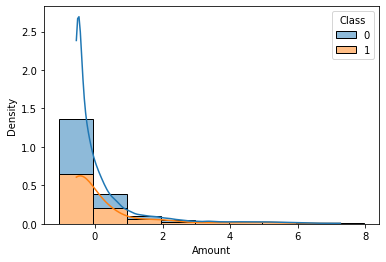

In [52]:
#sns.distplot(dftest2["V8"].values, ax=ax[0], color='r')
#sns.distplot(dftest2["V8"].values)
sns.histplot(dftest2, x="Amount", hue="Class", multiple="stack",discrete=True, stat="density", common_norm=False, kde=True)

<a id="section_distributionsVi"></a>
### Distributions for the variables Vi.
There are very few cases where we statistically we could distinguish the  distribution functions of the Class 1 from the Class 0, for instance for the variables V10, V11, V12, V14, V17 we can see both peak separated, maybe the model can pick up on that so they become the most important features. On the other hand,  the variables  V20,V21, V23, V24, V25, V27, V28 where both show a close gaussian distribution and no way to distiguish between them. Also we can see that  V1, V3, V7,V10, V12, v14, V16, V17, V18  present large tails.

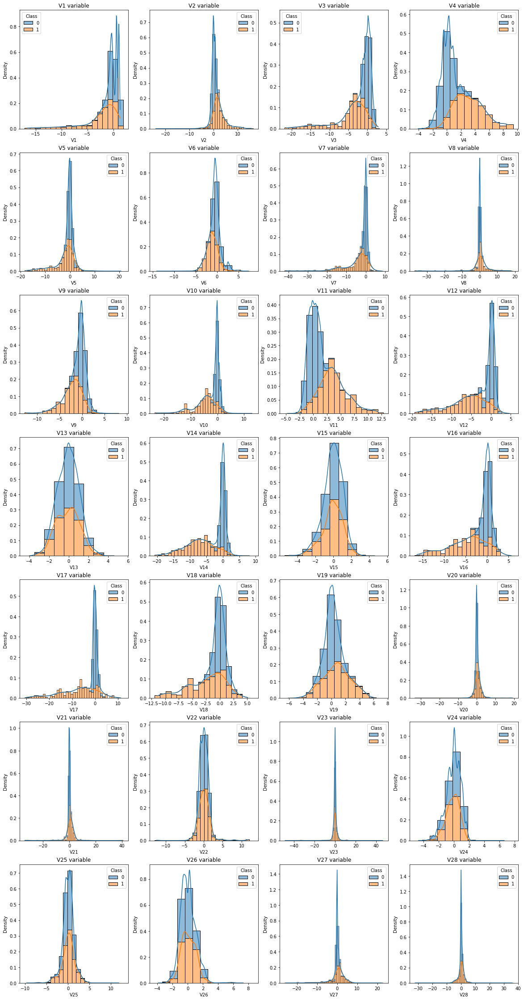

In [53]:
f,axes=plt.subplots(ncols=4, nrows=7, figsize=(20,40))
#print(axes[0,0])
for i, Vi in enumerate(creditcard_Vs.columns.tolist()):
    row = (i // 4) 
    col = (i % 4) 
    #print(row, col)
    sns.histplot(dftest2, x=Vi, ax=axes[row,col], hue="Class", multiple="stack",discrete=True, stat="density", common_norm=False, kde=True)
    axes[row,col].set_title(f'{Vi} variable')

In [54]:
#dftest2
import pickle
#pickle.dump(dftest2, open("card_df_standard.pkl", "wb"))
#dftest2 = pickle.load(open("card_df_standard.pkl","rb"))


Next section: ["Credit card fraud2_MLmodels"](./Credit card fraud2_MLmodels.ipynb)) 